<a href="https://colab.research.google.com/github/srujanreddy2021/AI_ML_IITH_Projects_Labs/blob/main/water_loading_prediction_with_water_level.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install -U plotly
!pip install -U kaleido

In [ ]:
folder_name='/content'

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.io as pio
import plotly.graph_objects as go
import kaleido
pd.options.plotting.backend = "plotly"
from scipy.signal import butter, filtfilt
pio.templates.default = "plotly_white" #"plotly", "plotly_white", "plotly_dark", "ggplot2", "seaborn" ,  "simple_white"


from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score,classification_report,confusion_matrix,ConfusionMatrixDisplay
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import SMOTE,ADASYN

import joblib
from joblib import dump, load

## Export plots

In [ ]:
import os

if not os.path.exists("images"):
    os.mkdir("images")

## Functions

data_load: to load flush,washing machine, geyser

load_water_data_ultrasonic : to load water level data


In [ ]:
start_time = '2024-05-06'
end_time = None

In [ ]:

def data_load(path,start_timestamp=start_time,end_timestamp=end_time):
  df = pd.read_csv(path,parse_dates=['created_at'])
  df = df.drop(columns=['latitude','longitude','elevation','status','entry_id','field3'])
  df = df.rename(columns={'created_at':'Timestamp','field1':'flow_rate','field2':'Volume_per_usage'})
  df = df.set_index(["Timestamp"], drop=True)
  df= df.fillna(0)

  df=df[start_timestamp:end_timestamp]
  return df

def load_water_data_ultrasonic(path,start_timestamp='2024-03-24 18:04:03+05:30',end_timestamp=None):
  water_level_data = pd.read_csv(path,parse_dates=['created_at'])
  water_level_data = water_level_data.drop(columns=['latitude','longitude','elevation','status','entry_id','field3'])
  water_level_data = water_level_data.rename(columns={'created_at':'Timestamp','field1':'flow_rate','field2':'Volume_per_usage','field4':'distance'})
  water_level_data = water_level_data.set_index(["Timestamp"], drop=True)
  water_level_data=water_level_data[start_timestamp:end_timestamp]
  return water_level_data
  # water_level_data['distance'] = water_level_data['distance'].apply(lambda x: round(x, 1))

## loading water loading and water level data

In [ ]:
flush_data = data_load(f'{folder_name}/flush.csv')
washing_machine_data = data_load(f'{folder_name}/washing_machine.csv')
bathroom_cabinet_data = data_load(f'{folder_name}/bathroom_cabinet.csv')
# geyser_data = data_load(f'{folder_name}/geyser.csv')
# jet_spary_data = data_load(f'{folder_name}/jet_spary.csv')
# tank_out_data = data_load(f'{folder_name}/tank_out.csv')
# tank_out_data =tank_out_data[start_time:end_time]
water_level_data = load_water_data_ultrasonic(f'{folder_name}/water_load_ultrasonic.csv',start_timestamp=start_time,end_timestamp=end_time)

## Adding zeros to the water level so that can be divided to group between on and off
for i in range(1, len(water_level_data)):
    if water_level_data['distance'].iloc[i] == 0 and water_level_data['distance'].iloc[i - 1] != 0:
        water_level_data['distance'].iloc[i-1] = 0
water_level_data.plot()

In [ ]:
# groups = []
# current_group = []
# for idx, val in water_level_data.iterrows():
#     if val['distance'] == 0:
#         if current_group:
#             groups.append(current_group)
#             current_group = []
#     current_group.append((idx, val['distance']))
# if current_group:
#     groups.append(current_group)

# # Applying rolling mean to each group and concatenating back
# processed_groups = []
# for group in groups:
#     timestamps, values = zip(*group)
#     group_df = pd.DataFrame({'distance': values}, index=timestamps)
#     group_df['distance'] = group_df['distance'].rolling(window=3, min_periods=1).mean()  # Adjust window size as needed
#     processed_groups.append(group_df)

# water_level_data['distance'] = pd.concat(processed_groups)

# water_level_data.plot()

## Calculating Volume , Volume_rate ,height

I have Divided the data groups of on and off of device water level data.

Calucalte Volume(liters) , Volume_rate(liters per minute) ,height(distance differnce of water level in cm)  in each group.

In [ ]:

# Grouping data between consecutive zeros
groups = []
current_group = []
next_zero_found = False
for idx, val in water_level_data.iterrows():
    current_group.append((idx, val['distance']))
    if val['distance'] == 0:
        if next_zero_found:
            groups.append(current_group)
            current_group = []
            next_zero_found = False
        else:
            next_zero_found = True

if current_group:
    groups.append(current_group)


# Calculate volume and volume rate for each group
processed_groups = []
for group in groups:
    timestamps, levels = zip(*group)
    # Assume radius of the cylindrical tank
    radius_cm = 83.0/2
    # Replace with the actual radius of your tank in centimeters

    # Calculate heights in centimeters, considering levels equal to 0
    heights_cm = [abs(levels[i] - levels[i-1]) if levels[i] != 0 and levels[i-1] != 0 else 0 for i in range(1, len(levels))]
    volumes_cm3 = [np.pi * (radius_cm**2) * h for h in heights_cm]  # Calculate volumes in cubic centimeters
    volumes_liters = [v / 1000.0 for v in volumes_cm3]  # Convert volumes to liters

     # Set volume values to zero if they exceed a threshold
    threshold_v = 5.2  # Define your threshold here
    volumes_liters = [0 if v > threshold_v else v for v in volumes_liters]


    # Calculate time differences in minutes
    time_diffs = [(timestamps[i] - timestamps[i-1]).total_seconds() / 60.0 for i in range(1, len(timestamps))]

    # Calculate volume rate in liters per minute
    volume_rates = [volumes_liters[i-1] / time_diffs[i-1] for i in range(1, len(volumes_liters)+1)]
    threshold_vlp = 10.1
    volume_rates = [0 if v > threshold_vlp else v for v in volume_rates]
    threshold_h = 1
    heights_cm = [0 if v > threshold_h else v for v in heights_cm]

    volume_df = pd.DataFrame({'height_cm':heights_cm,'volume_liters': volumes_liters, 'volume_rate_lpm': volume_rates}, index=timestamps[1:])

    # Applying rolling mean
    volume_df['volume_liters'] = volume_df['volume_liters'][1:-1].rolling(window=5, min_periods=1).mean()# Apply rolling mean to volume
    volume_df['volume_rate_lpm'] = volume_df['volume_rate_lpm'][1:-1].rolling(window=5, min_periods=1).mean()  # Apply rolling mean to volume rate
    # volume_df['heights_cm'] = volume_df['heights_cm'][1:-1].rolling(window=3, min_periods=1).mean()  # Apply rolling mean to volume rate
    volume_df.fillna(0, inplace=True)
    # print(volume_df)
    # print("\n\n")

    processed_groups.append(volume_df)
result_df = pd.concat(processed_groups)
water_level_data['volume_liters']=result_df['volume_liters']
water_level_data['volume_rate_lpm']=result_df['volume_rate_lpm']
water_level_data['height_cm']=result_df['height_cm']

## resampling and interolating the data to 1 min

In [ ]:
def resample_data(df, sampling_rate='2S'):
    df = df.resample(sampling_rate).ffill()

    return df
water_level_res = resample_data(water_level_data)
flush_res = resample_data(flush_data).dropna()
washing_machine_res = resample_data(washing_machine_data).dropna()
bathroom_cabinet_res = resample_data(bathroom_cabinet_data).dropna()

In [ ]:
## Removing continous value
def remove_continuous_value(df,column_name,threshold =7):
  # Identify continuous sequences of identical volume values
  is_continuous = df[column_name] != df[column_name].shift()

  # Use cumulative sum to create groups for each continuous sequence
  groups = is_continuous.cumsum()

  # Count the size of each group
  group_sizes = groups.value_counts()

  # Set all but the initial value of each sequence to zero
  for group, size in group_sizes.items():
      if size > threshold:
          indices = groups[groups == group].index
          df.loc[indices[1:], column_name] = 0

  return df[column_name]

water_level_res['volume_liters']=remove_continuous_value(water_level_res,'volume_liters')
water_level_res['volume_rate_lpm']=remove_continuous_value(water_level_res,'volume_rate_lpm')
water_level_res['height_cm']=remove_continuous_value(water_level_res,'height_cm')

In [ ]:
px.box(water_level_res[water_level_res['volume_rate_lpm']!=0], y='volume_rate_lpm')

In [ ]:
# Plotting using Plotly
fig = go.Figure()

# Add traces
fig.add_trace(go.Scatter(x=water_level_res.index, y=water_level_res['volume_rate_lpm'], mode='lines', name='water level volume rate'))
fig.add_trace(go.Scatter(x=water_level_res.index, y=water_level_res['height_cm'], mode='lines', name='water level height difference'))
fig.add_trace(go.Scatter(x=water_level_res.index, y=water_level_res['volume_liters'], mode='lines', name='water level volume'))
fig.add_trace(go.Scatter(x=flush_res.index, y=flush_res['flow_rate'], mode='lines', name='Flush flowrate'))
fig.add_trace(go.Scatter(x=washing_machine_res.index, y=washing_machine_res['flow_rate'], mode='lines', name='Washing Machine flowrate'))
fig.add_trace(go.Scatter(x=bathroom_cabinet_res.index, y=bathroom_cabinet_res['flow_rate'], mode='lines', name='Bathroom Cabinet flowrate'))
# fig.add_trace(go.Scatter(x=water_level_res.index, y=water_level_res['distance'], mode='lines', name='water level distance'))


# Update layout
fig.update_layout(title='ALL Data',
                  xaxis_title='Timestamp',
                  yaxis_title='Value')

# Show plot
fig.show()

## Labeling the data

In [ ]:
 # Create binary labels for each appliance

water_level_res['flush'] = flush_res['flow_rate']
water_level_res['washing_machine'] = washing_machine_res['flow_rate']
water_level_res['bathroom_cabinet'] = bathroom_cabinet_res['flow_rate']
water_level_res.fillna(0,inplace=True)
# Function to assign labels
def assign_labels(row):
    labels = []
    if row['flush'] > 0:
        labels.append('flush')
    if row['washing_machine'] > 0:
        labels.append('washing_machine')
    if row['bathroom_cabinet'] > 0:
        labels.append('bathroom_cabinet')
    if labels:
        return np.random.choice(labels)  # Choose random label if multiple
    else:
        return ''

# Assign labels to water level data
water_level_res['labels'] = water_level_res.apply(assign_labels, axis=1)

def group_labels(df_label, group_column):
    df_label['is_transition'] = (df_label[group_column] == 0.0) & ((df_label[group_column].shift(-1) != 0.0) | ((df_label[group_column].shift(1) == 0.0) & (df_label[group_column].shift(2) != 0.0)) )
    groups = df_label['is_transition'].cumsum()
    df_label['group_label'] = df_label.groupby(groups)['labels'].transform(lambda x: np.unique(x)[np.argmax(np.unique(x, return_counts=True)[1])])
    return df_label['group_label']

water_level_res['grouped_labels'] = group_labels(water_level_res, 'volume_liters')

water_level_res = water_level_res[water_level_res['grouped_labels']!='']

fig = go.Figure()

# Count the occurrences of each label in 'labels' column
label_counts = water_level_res['grouped_labels'].explode().value_counts()

# Create the bar trace
fig.add_trace(go.Bar(
    x=label_counts.index,
    y=label_counts.values,
    marker_color=['blue', 'green', 'red', 'brown', 'violet']  # Assign colors to each label
))

# Update layout and labels
fig.update_layout(
    title='Number of Labels in corr_df',
    xaxis_title='Labels',
    yaxis_title='Count'
)

fig.show()

## Plotting the Original data

In [ ]:
colors = px.colors.qualitative.Plotly

def plot_predictions_plotly(data,labels,column_name,title_name,start=None,end=None):
  df = pd.DataFrame({'data': data[column_name][start:end], 'labels': labels[start:end]})

  # Define colors for each label
  color_map = {'flush': colors[0], 'washing_machine': colors[1], 'bathroom_cabinet':colors[2],'':colors[3]}

  # Create a figure
  fig = go.Figure()

  # Dictionary to keep track of added colors in the legend
  legend_colors = {}

  # Add line traces to the figure with different colors based on labels
  for i in range(len(df) - 1):
      x_values_segment = [df.index.to_series()[i], df.index.to_series()[i+1]]
      y_values_segment = [df.iloc[i]['data'], df.iloc[i + 1]['data']]
      label_color = color_map[df.iloc[i]['labels']]

      # Check if color already added to legend
      if label_color not in legend_colors:
          line_trace = go.Scatter(
              x=x_values_segment,
              y=y_values_segment,
              mode='lines',
              line=dict(color=label_color),
              name=df.iloc[i]['labels'],  # Use label name as legend name
          )
          fig.add_trace(line_trace)
          legend_colors[label_color] = df.iloc[i]['labels']  # Add color to legend_colors dictionary

      else:
          line_trace = go.Scatter(
              x=x_values_segment,
              y=y_values_segment,
              mode='lines',
              line=dict(color=label_color),
              name=df.iloc[i]['labels'],
              showlegend=False,  # Do not show duplicate legend entries
          )
          fig.add_trace(line_trace)

  # Update layout
  fig.update_layout(
      title=title_name,
      xaxis_title='Timestamp',
      yaxis_title=column_name,
      legend=dict(title='Labels')  # Custom legend title
  )

  # Show the plot
  fig.show()

In [ ]:
plot_predictions_plotly(water_level_res,water_level_res['grouped_labels'],'volume_liters',start='2024-05-10 10:00:00+05:30',end=None,title_name='Original data')

## water level Model Training

1) Removing unwanted columns from water_level_res

2) Apply LabelEncoder to target variable y

3) Apply StandardScaler to features X

4) balancing data with SMOTE and ADASYN

5)

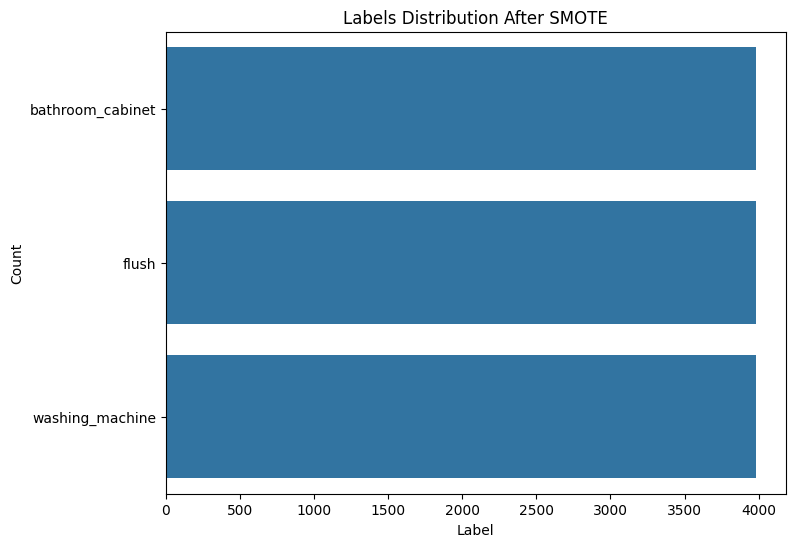

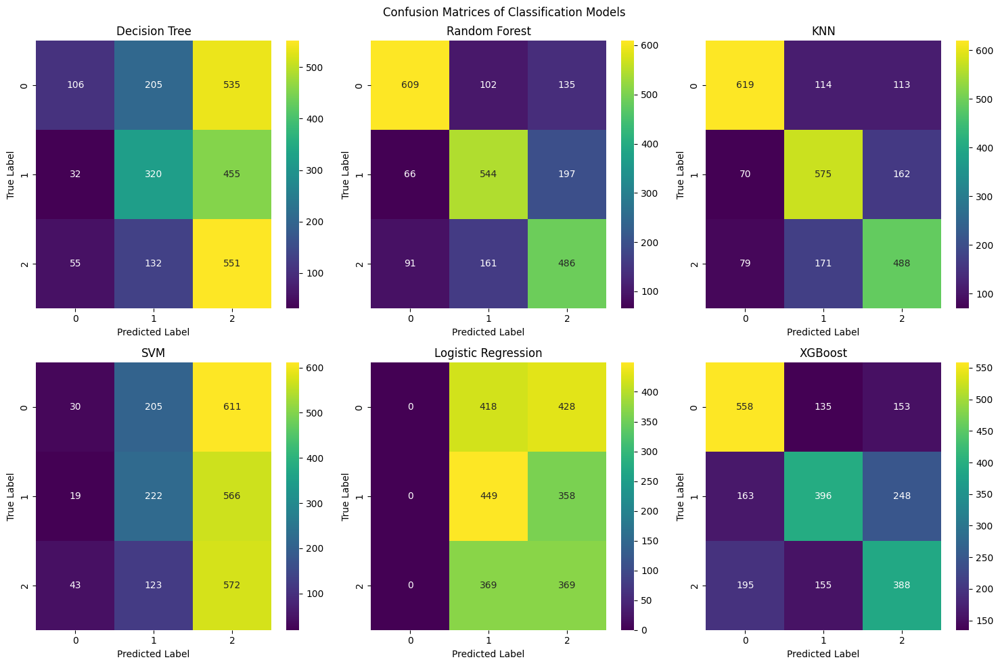

In [ ]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier

from imblearn.over_sampling import SMOTE

data=water_level_res[:'2024-05-09 22:00:00+05:30'].copy()
data_val=water_level_res['2024-05-10 10:00:00+05:30':].copy()

data.drop(columns=['flow_rate', 'Volume_per_usage', 'flush', 'washing_machine', 'bathroom_cabinet',
       'labels', 'is_transition', 'group_label'], inplace=True)

data_val.drop(columns=['flow_rate', 'Volume_per_usage', 'flush', 'washing_machine', 'bathroom_cabinet',
       'labels', 'is_transition', 'group_label'], inplace=True)


# Remove data points where volume_liters is zero and include where its before andA after value is not zero

# data = data[data['volume_liters'] != 0]

data = data[(data['volume_liters'] != 0) |
                                    ((data['volume_liters'].shift() != 0) &
                                     (data['volume_liters'].shift(-1) != 0))]



# Prepare features (X) and target variable (y)
X = data.drop(columns=['grouped_labels','distance','volume_rate_lpm','height_cm'])
y = data['grouped_labels']

X_val = data_val.drop(columns=['grouped_labels','distance','volume_rate_lpm','height_cm'])
y_val = data_val['grouped_labels']

# Apply LabelEncoder to target variable y
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Apply StandardScaler to features X
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_val_scaled = scaler.transform(X_val)


# Apply SMOTE to oversample the minority classes
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_scaled, y)

# Convert back to original labels
y_resampled_labels = label_encoder.inverse_transform(y_resampled)

# Display labels distribution after applying SMOTE
plt.figure(figsize=(8, 6))
sns.countplot(y_resampled_labels )
plt.title('Labels Distribution After SMOTE')
plt.xlabel('Label')
plt.ylabel('Count')
plt.show()

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=0)


# Define models with parameters
models = {
    'Decision Tree': DecisionTreeClassifier(max_depth=5, random_state=42),
    'Random Forest': RandomForestClassifier(n_estimators=100, random_state=42),
    'KNN': KNeighborsClassifier(n_neighbors=5),
    'SVM': SVC(kernel='rbf'),
    'Logistic Regression': LogisticRegression(max_iter=1000),
    'XGBoost': XGBClassifier(n_estimators=100),
    'MLP': MLPClassifier(hidden_layer_sizes=100, random_state=42)
}

# Train and evaluate models
confusion_matrices = {}
accuracies = {}
y_pred_values = {}
accuracies_val = {}
models_save = {}
y_pred_grouped_values = {}
accuracies_grouped_val = {}

for name, model in models.items():
    model.fit(X_train, y_train)
    models_save[name]=model
    y_pred = model.predict(X_test)
    confusion_matrices[name] = confusion_matrix(y_test, y_pred)
    accuracies[name] = accuracy_score(y_test, y_pred) * 100
    y_pred_val = model.predict(X_val_scaled)
    y_pred_val = label_encoder.inverse_transform(y_pred_val)
    y_pred_values[name] = y_pred_val
    accuracies_val[name] = accuracy_score(y_pred_val, y_val) * 100
    dt_data= pd.DataFrame({'volume_liters':data_val['volume_liters'],'labels':y_pred_val})
    y_pred_grouped_val= group_labels(dt_data,'volume_liters')
    y_pred_grouped_values[name] = y_pred_grouped_val
    accuracies_grouped_val[name] = accuracy_score(y_pred_grouped_val, y_val) * 100




# Plot confusion matrices using seaborn
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
fig.suptitle('Confusion Matrices of Classification Models')

for ax, (name, cm) in zip(axes.flatten(), confusion_matrices.items()):
    sns.heatmap(cm, annot=True, cmap='viridis', fmt='d', ax=ax)
    ax.set_title(name)
    ax.set_xlabel('Predicted Label')
    ax.set_ylabel('True Label')

plt.tight_layout()
plt.show()


# Plot accuracies
fig = go.Figure(go.Bar(x=list(accuracies.keys()), y=list(accuracies.values()), text=[f"{value:.1f}" for value in accuracies.values()],
            textposition='auto',marker=dict(color='#DD5746')))
fig.update_layout(title='Accuracy of Classification Models',
                  xaxis_title='Model',
                  yaxis_title='Accuracy')

fig.show()

# Plot accuracies
fig = go.Figure(go.Bar(x=list(accuracies_val.keys()), y=list(accuracies_val.values()),text=[f"{value:.1f}" for value in accuracies_val.values()],
            textposition='auto', marker=dict(color='#DD5746')))
fig.update_layout(title='Accuracy of predictions of Classification Models',
                  xaxis_title='Model',
                  yaxis_title='Accuracy')

fig.show()

# Plot accuracies
fig = go.Figure(go.Bar(x=list(accuracies_grouped_val.keys()), y=list(accuracies_grouped_val.values()),text=[f"{value:.1f}" for value in accuracies_grouped_val.values()],
            textposition='auto', marker=dict(color='#DD5746')))
fig.update_layout(title='Accuracy of grouped predictions of Classification Models',
                  xaxis_title='Model',
                  yaxis_title='Accuracy')

fig.show()



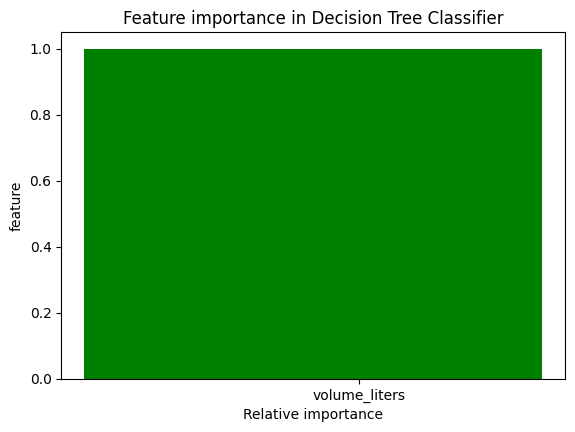

<Figure size 500x500 with 0 Axes>

In [ ]:
# RANDOM FOREST feature Importance
y = models_save['Decision Tree'].feature_importances_
#plot
fig, ax = plt.subplots()
width = 0.4 # the width of the bars
ind = np.arange(len(y)) # the x locations for the groups
ax.bar(ind, y, width, color="green")
ax.set_xticks(ind+width/10)
ax.set_xticklabels(X.columns, minor=False)
plt.title('Feature importance in Decision Tree Classifier')
plt.xlabel('Relative importance')
plt.ylabel('feature')
plt.figure(figsize=(5,5))
fig.set_size_inches(6.5, 4.5, forward=True)

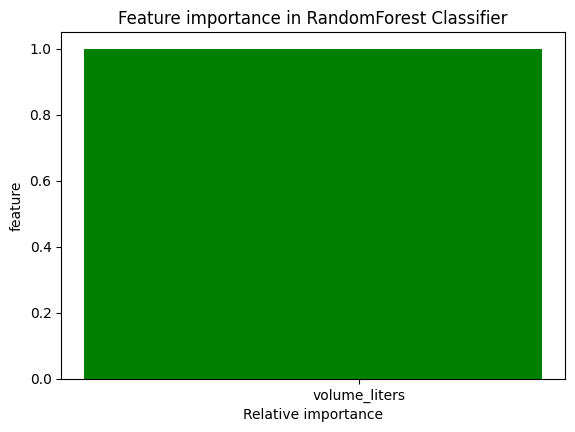

<Figure size 500x500 with 0 Axes>

In [ ]:
# RANDOM FOREST feature Importance
y = models_save['Random Forest'].feature_importances_
#plot
fig, ax = plt.subplots()
width = 0.4 # the width of the bars
ind = np.arange(len(y)) # the x locations for the groups
ax.bar(ind, y, width, color="green")
ax.set_xticks(ind+width/10)
ax.set_xticklabels(X.columns, minor=False)
plt.title('Feature importance in RandomForest Classifier')
plt.xlabel('Relative importance')
plt.ylabel('feature')
plt.figure(figsize=(5,5))
fig.set_size_inches(6.5, 4.5, forward=True)

In [ ]:
for name, y_pred_grouped_value in y_pred_grouped_values.items():
  plot_predictions_plotly(data_val,y_pred_grouped_value,'volume_liters',start='2024-05-08 10:00:00+05:30',end=None,title_name=f'{name} Prediction data')

## Time Series

In [ ]:
def create_time_series_windows_df(X_df, window_size):
    if isinstance(X_df, pd.DataFrame):
        X = X_df.values

    n_samples, n_features = X.shape
    column_names = X_df.columns
    time_series_data = []


    feature_names = [f'{i}' for i in column_names]

    for i in range(n_samples - window_size + 1):
        window = X[i:i+window_size]
        time_series_data.append(window.ravel())

    columns = [f'{name}_t-{t}' for t in reversed(range(window_size)) for name in feature_names]
    window_df = pd.DataFrame(time_series_data, columns=columns)
    cols = list(window_df.columns)
    cols.reverse()
    return window_df[cols]



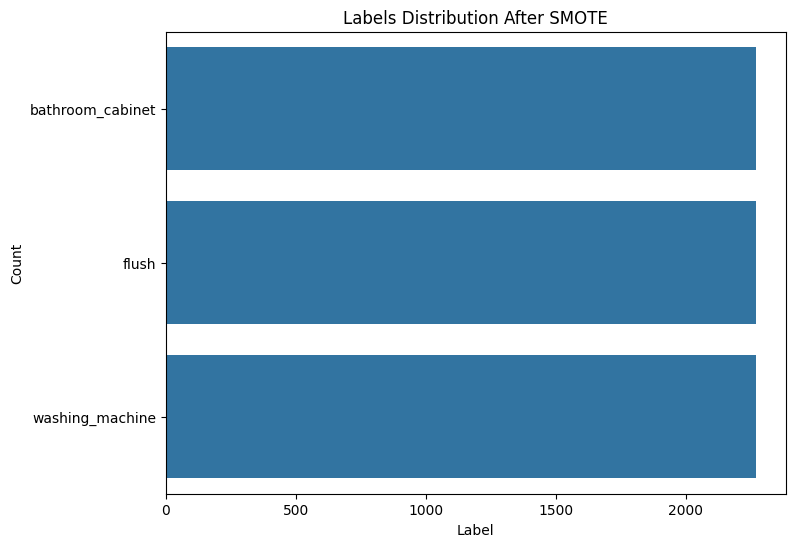

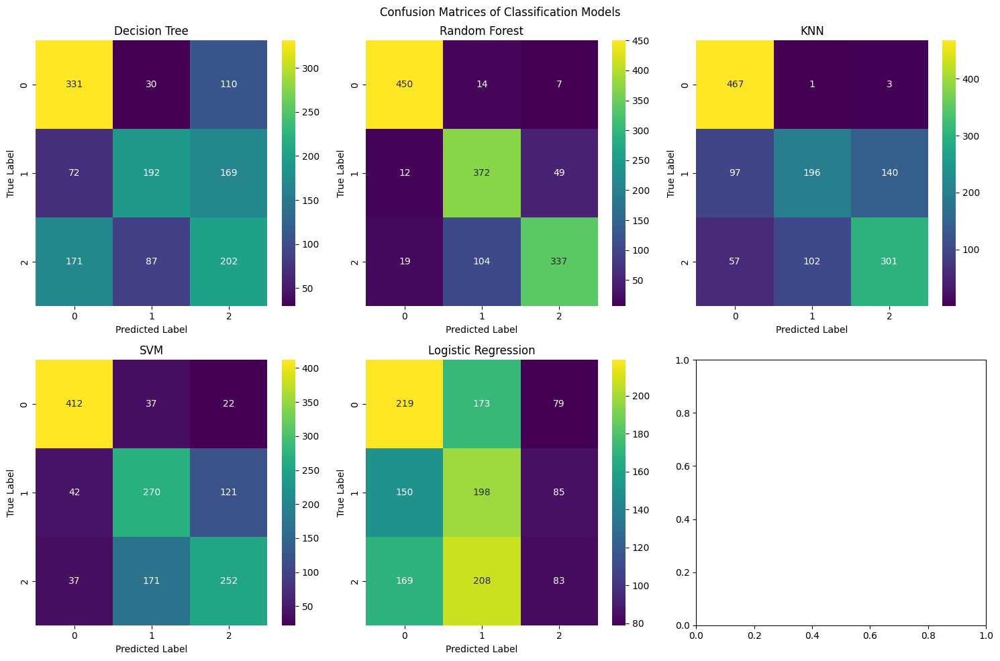

In [ ]:
# loding data
data=water_level_res[:'2024-05-07 22:00:00+05:30'].copy()
data_val=water_level_res['2024-05-08 10:00:00+05:30':].copy()

# removing unwanted labels

data.drop(columns=['flow_rate', 'Volume_per_usage',
       'volume_rate_lpm', 'flush', 'washing_machine', 'bathroom_cabinet',
       'labels', 'is_transition', 'group_label'], inplace=True)

data_val.drop(columns=['flow_rate', 'Volume_per_usage',
       'volume_rate_lpm', 'flush', 'washing_machine', 'bathroom_cabinet',
       'labels', 'is_transition', 'group_label'], inplace=True)


# Remove data points where volume_liters is zero and include where its before andA after value is not zero

data = data[data['volume_liters'] != 0]

# data = data[(data['volume_liters'] != 0) |
#                                     ((data['volume_liters'].shift() != 0) &
#                                      (data['volume_liters'].shift(-1) != 0))]



# Prepare features (X) and target variable (y)
X = data.drop(columns=['grouped_labels','distance'])
y = data['grouped_labels']

# Making Time Series data
window_size = 10
X = create_time_series_windows_df(X, window_size=window_size)
y=y[window_size-1:]

X_val = data_val.drop(columns=['grouped_labels','distance'])
y_val = data_val['grouped_labels']
X_val = create_time_series_windows_df(X_val, window_size=window_size)
y_val=y_val[window_size-1:]

# Apply LabelEncoder to target variable y
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Apply StandardScaler to features X
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_val_scaled = scaler.transform(X_val)

# Apply SMOTE to oversample the minority classes
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_scaled, y)

# Convert back to original labels
y_resampled_labels = label_encoder.inverse_transform(y_resampled)

# Display labels distribution after applying SMOTE
plt.figure(figsize=(8, 6))
sns.countplot(y_resampled_labels)
plt.title('Labels Distribution After SMOTE')
plt.xlabel('Label')
plt.ylabel('Count')
plt.show()

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=0)


# Define models with parameters
models = {
    'Decision Tree': DecisionTreeClassifier(max_depth=5),
    'Random Forest': RandomForestClassifier(),
    'KNN': KNeighborsClassifier(n_neighbors=5),
    'SVM': SVC(kernel='rbf'),
    'Logistic Regression': LogisticRegression(max_iter=1000)
}

# Train and evaluate models
confusion_matrices = {}
accuracies = {}
y_pred_values = {}
accuracies_val = {}
models_save = {}
y_pred_grouped_values = {}
accuracies_grouped_val = {}

for name, model in models.items():
    model.fit(X_train, y_train)
    models_save[name]=model
    y_pred = model.predict(X_test)
    confusion_matrices[name] = confusion_matrix(y_test, y_pred)
    accuracies[name] = accuracy_score(y_test, y_pred) * 100
    y_pred_val = model.predict(X_val_scaled)
    y_pred_val = label_encoder.inverse_transform(y_pred_val)
    y_pred_values[name] = y_pred_val
    accuracies_val[name] = accuracy_score(y_pred_val, y_val) * 100
    dt_data= pd.DataFrame({'volume_liters':data_val['volume_liters'][window_size-1:],'labels':y_pred_val})
    y_pred_grouped_val= group_labels(dt_data,'volume_liters')
    y_pred_grouped_values[name] = y_pred_grouped_val
    accuracies_grouped_val[name] = accuracy_score(y_pred_grouped_val, y_val) * 100




# Plot confusion matrices using seaborn
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
fig.suptitle('Confusion Matrices of Classification Models')

for ax, (name, cm) in zip(axes.flatten(), confusion_matrices.items()):
    sns.heatmap(cm, annot=True, cmap='viridis', fmt='d', ax=ax)
    ax.set_title(name)
    ax.set_xlabel('Predicted Label')
    ax.set_ylabel('True Label')

plt.tight_layout()
plt.show()


# Plot accuracies
fig = go.Figure(go.Bar(x=list(accuracies.keys()), y=list(accuracies.values()), marker=dict(color='blue')))
fig.update_layout(title='Accuracy of Classification Models',
                  xaxis_title='Model',
                  yaxis_title='Accuracy')

fig.show()

# Plot accuracies
fig = go.Figure(go.Bar(x=list(accuracies_val.keys()), y=list(accuracies_val.values()), marker=dict(color='blue')))
fig.update_layout(title='Accuracy of predictions of Classification Models',
                  xaxis_title='Model',
                  yaxis_title='Accuracy')

fig.show()

# Plot accuracies
fig = go.Figure(go.Bar(x=list(accuracies_grouped_val.keys()), y=list(accuracies_grouped_val.values()), marker=dict(color='blue')))
fig.update_layout(title='Accuracy of grouped predictions of Classification Models',
                  xaxis_title='Model',
                  yaxis_title='Accuracy')

fig.show()



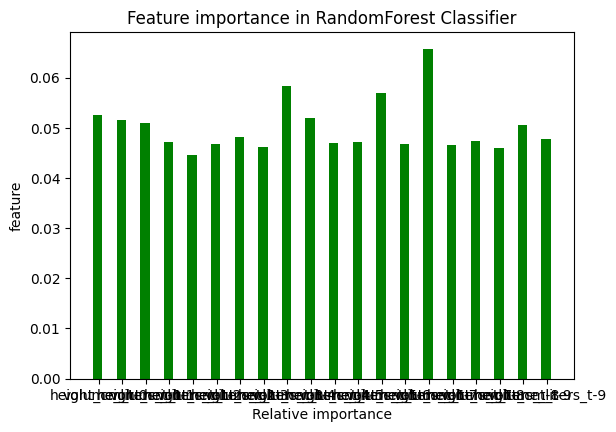

<Figure size 500x500 with 0 Axes>

In [ ]:
#modelname.feature_importance_
y = models_save['Random Forest'].feature_importances_
#plot
fig, ax = plt.subplots()
width = 0.4 # the width of the bars
ind = np.arange(len(y)) # the x locations for the groups
ax.bar(ind, y, width, color="green")
ax.set_xticks(ind+width/10)
ax.set_xticklabels(X.columns, minor=False)
plt.title('Feature importance in RandomForest Classifier')
plt.xlabel('Relative importance')
plt.ylabel('feature')
plt.figure(figsize=(5,5))
fig.set_size_inches(6.5, 4.5, forward=True)

In [ ]:
X.columns

Index(['height_cm_t-0', 'volume_liters_t-0', 'height_cm_t-1',
       'volume_liters_t-1', 'height_cm_t-2', 'volume_liters_t-2',
       'height_cm_t-3', 'volume_liters_t-3', 'height_cm_t-4',
       'volume_liters_t-4', 'height_cm_t-5', 'volume_liters_t-5',
       'height_cm_t-6', 'volume_liters_t-6', 'height_cm_t-7',
       'volume_liters_t-7', 'height_cm_t-8', 'volume_liters_t-8',
       'height_cm_t-9', 'volume_liters_t-9'],
      dtype='object')

In [ ]:
for name, y_pred_grouped_value in y_pred_grouped_values.items():
  plot_predictions_plotly(data_val[window_size-1:],y_pred_grouped_value,'volume_liters',start='2024-05-08 10:00:00+05:30',end=None,title_name=f'{name} Prediction data')